In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb 
import plotly.express as px
color_pal = sns.color_palette()
plt.style.use('fivethirtyeight') 

In [ ]:
data = pd.read_csv("/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/data/dataset/energy_generated_data.csv",index_col=[0],
                  parse_dates=[0])
data = data.sort_index()
data.head()

,respondent,respondent-name,fueltype,type-name,value,value-units
period,,,,,,
2022-01-01 00:00:00,NY,New York,WAT,Hydro,3962,megawatthours
2022-01-01 01:00:00,NY,New York,WAT,Hydro,3970,megawatthours
2022-01-01 02:00:00,NY,New York,WAT,Hydro,3963,megawatthours
2022-01-01 03:00:00,NY,New York,WAT,Hydro,3750,megawatthours
2022-01-01 04:00:00,NY,New York,WAT,Hydro,3513,megawatthours


### Feature Engineering

In [ ]:
df = data.copy()
df['Seconds'] = df.index.map(pd.Timestamp.timestamp)
columnstodrop = ['respondent','respondent-name','fueltype','type-name','value-units']
df.drop(columns=columnstodrop, axis=1, inplace=True)

print(type(df))
df.head()

<class 'pandas.core.frame.DataFrame'>


,value,Seconds
period,,
2022-01-01 00:00:00,3962,1.640995e+09
2022-01-01 01:00:00,3970,1.640999e+09
2022-01-01 02:00:00,3963,1.641002e+09
2022-01-01 03:00:00,3750,1.641006e+09
2022-01-01 04:00:00,3513,1.641010e+09


In [ ]:
from datetime import timedelta
 
# Constants for cyclic features
day = 60 * 60 * 24
year = timedelta(days=365.2425).total_seconds()
hour = 60 * 60
minute = 60 

# Extract cyclic features
df['Day sin'] = np.sin(2 * np.pi * df['Seconds'] / day)
df['Day cos'] = np.cos(2 * np.pi * df['Seconds'] / day)
df['Year sin'] = np.sin(2 * np.pi * df['Seconds'] / year)
df['Year cos'] = np.cos(2 * np.pi * df['Seconds'] / year)

# Extract hours and minutes
df['Hour'] = (df['Seconds'] // hour) % 24
df['Minute'] = (df['Seconds'] // minute) % 60

# Cyclic encoding for hours and minutes
df['Hour sin'] = np.sin(2 * np.pi * df['Hour'] / 24)
df['Hour cos'] = np.cos(2 * np.pi * df['Hour'] / 24)
df['Minute sin'] = np.sin(2 * np.pi * df['Minute'] / 60)
df['Minute cos'] = np.cos(2 * np.pi * df['Minute'] / 60)

# Convert seconds to datetime to extract month
df['Datetime'] = pd.to_datetime(df['Seconds'], unit='s', origin='unix')
df['Month'] = df['Datetime'].dt.month

# Cyclic encoding for months
df['Month sin'] = np.sin(2 * np.pi * df['Month'] / 12)
df['Month cos'] = np.cos(2 * np.pi * df['Month'] / 12)

# Drop unnecessary columns
df = df.drop(['Seconds', 'Hour', 'Minute', 'Month', 'Datetime'], axis=1)

# Display the result
df.head()

86400
31556952.0
3600
60


,value,Day sin,Day cos,Year sin,Year cos,Hour sin,Hour cos,Minute sin,Minute cos,Month sin,Month cos
period,,,,,,,,,,,
2022-01-01 00:00:00,3962,-8.652299e-12,1.000000,0.006709,0.999977,0.000000,1.000000,0.0,1.0,0.5,0.866025
2022-01-01 01:00:00,3970,2.588190e-01,0.965926,0.007426,0.999972,0.258819,0.965926,0.0,1.0,0.5,0.866025
2022-01-01 02:00:00,3963,5.000000e-01,0.866025,0.008143,0.999967,0.500000,0.866025,0.0,1.0,0.5,0.866025
2022-01-01 03:00:00,3750,7.071068e-01,0.707107,0.008859,0.999961,0.707107,0.707107,0.0,1.0,0.5,0.866025
2022-01-01 04:00:00,3513,8.660254e-01,0.500000,0.009576,0.999954,0.866025,0.500000,0.0,1.0,0.5,0.866025


In [ ]:
# Add rolling mean and rolling std
df['rolling_mean_3h'] = df['value'].rolling(window=3).mean()
df['rolling_std_3h'] = df['value'].rolling(window=3).std()

df['rolling_mean_24h'] = df['value'].rolling(window=24).mean()  # Daily average
df['rolling_std_24h'] = df['value'].rolling(window=24).std()

# Correct way to forward fill without warning
df['rolling_mean_3h'] = df['rolling_mean_3h'].ffill()
df['rolling_std_3h'] = df['rolling_std_3h'].ffill()

df['rolling_mean_24h'] = df['rolling_mean_24h'].ffill()
df['rolling_std_24h'] = df['rolling_std_24h'].ffill()

# Backward fill any remaining NaN values
df = df.fillna(method='ffill')

# Check the updated dataset
df.head()


,value,Day sin,Day cos,Year sin,Year cos,Hour sin,Hour cos,Minute sin,Minute cos,Month sin,Month cos,rolling_mean_3h,rolling_std_3h,rolling_mean_24h,rolling_std_24h
period,,,,,,,,,,,,,,,
2022-01-01 00:00:00,3962,-8.652299e-12,1.000000,0.006709,0.999977,0.000000,1.000000,0.0,1.0,0.5,0.866025,NaN,NaN,NaN,NaN
2022-01-01 01:00:00,3970,2.588190e-01,0.965926,0.007426,0.999972,0.258819,0.965926,0.0,1.0,0.5,0.866025,NaN,NaN,NaN,NaN
2022-01-01 02:00:00,3963,5.000000e-01,0.866025,0.008143,0.999967,0.500000,0.866025,0.0,1.0,0.5,0.866025,3965.000000,4.358899,NaN,NaN
2022-01-01 03:00:00,3750,7.071068e-01,0.707107,0.008859,0.999961,0.707107,0.707107,0.0,1.0,0.5,0.866025,3894.333333,125.045325,NaN,NaN
2022-01-01 04:00:00,3513,8.660254e-01,0.500000,0.009576,0.999954,0.866025,0.500000,0.0,1.0,0.5,0.866025,3742.000000,225.106641,NaN,NaN



**Lag and Autocorrelation**

For timeseries,lag refers to the time difference between observations in the series. It represents how far back in time you are looking when examining the relationship between observations.

Autocorrelation measures the linear relationship between an observation and its lagged values. It quantifies the degree of similarity or dependence between observations at different time points. Positive autocorrelation indicates that observations tend to be similar at higher lags, while negative autocorrelation indicates that observations tend to be dissimilar.

In a stationary time series, the autocorrelation between observations tends to decrease rapidly as the lag increases. Slowly diminishing autocorrelations can indicate non-stationarity, but it can also occur in certain stationary time series with long-term dependencies or trends.

Figure 1 and 2 below, clearly illustrate a positive correlation between two observations in the timeseries indicating that each observation is positively correlated by its preceding observation (Figure 1). This is a characteristic commonly observed in time series data, and it does not necessarily imply non-stationarity on its own. The autocorelations tend to be diminish slowly. It might be because of seasonality patterns in our timseries.

To conclude, our time series exhibits non-stationary behavior. The slow decay of autocorrelations and the presence of seasonality patterns indicate the need for careful consideration when applying forecasting models like ARIMA.


In [ ]:
df.shape
# Add lag features
for lag in range(1, 4):  # Add 3 lag features
    df[f'lag_{lag}'] = df['value'].shift(lag)

# Fill missing values first with forward fill, then backfill
df.fillna(method='ffill', inplace=True)
df.fillna(method='bfill', inplace=True)

# Check the updated dataset
df.head()

,value,Day sin,Day cos,Year sin,Year cos,Hour sin,Hour cos,Minute sin,Minute cos,Month sin,Month cos,rolling_mean_3h,rolling_std_3h,rolling_mean_24h,rolling_std_24h,lag_1,lag_2,lag_3
period,,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00,3962,-8.652299e-12,1.000000,0.006709,0.999977,0.000000,1.000000,0.0,1.0,0.5,0.866025,3965.000000,4.358899,3260.458333,546.003502,3962.0,3962.0,3962.0
2022-01-01 01:00:00,3970,2.588190e-01,0.965926,0.007426,0.999972,0.258819,0.965926,0.0,1.0,0.5,0.866025,3965.000000,4.358899,3260.458333,546.003502,3962.0,3962.0,3962.0
2022-01-01 02:00:00,3963,5.000000e-01,0.866025,0.008143,0.999967,0.500000,0.866025,0.0,1.0,0.5,0.866025,3965.000000,4.358899,3260.458333,546.003502,3970.0,3962.0,3962.0
2022-01-01 03:00:00,3750,7.071068e-01,0.707107,0.008859,0.999961,0.707107,0.707107,0.0,1.0,0.5,0.866025,3894.333333,125.045325,3260.458333,546.003502,3963.0,3970.0,3962.0
2022-01-01 04:00:00,3513,8.660254e-01,0.500000,0.009576,0.999954,0.866025,0.500000,0.0,1.0,0.5,0.866025,3742.000000,225.106641,3260.458333,546.003502,3750.0,3963.0,3970.0


In [ ]:
df.describe()

,value,Day sin,Day cos,Year sin,Year cos,Hour sin,Hour cos,Minute sin,Minute cos,Month sin,Month cos,rolling_mean_3h,rolling_std_3h,rolling_mean_24h,rolling_std_24h,lag_1,lag_2,lag_3
count,25561.000000,2.556100e+04,2.556100e+04,25561.000000,25561.000000,2.556100e+04,2.556100e+04,25561.0,25561.0,2.556100e+04,2.556100e+04,25561.000000,25561.000000,25561.000000,25561.000000,25561.000000,25561.000000,25561.000000
mean,3036.591409,-1.854396e-14,3.912210e-05,0.007255,-0.027539,-1.855511e-17,3.912210e-05,0.0,1.0,-4.719327e-03,-3.103767e-02,3036.605571,163.503559,3036.745688,529.925077,3036.605962,3036.618951,3036.633465
std,625.980099,7.071068e-01,7.071344e-01,0.715492,0.698068,7.071068e-01,7.071344e-01,0.0,0.0,7.159985e-01,6.974236e-01,601.549582,135.207502,315.705689,155.044350,625.997290,626.013047,626.030201
min,0.000000,-1.000000e+00,-1.000000e+00,-1.000000,-1.000000,-1.000000e+00,-1.000000e+00,0.0,1.0,-1.000000e+00,-1.000000e+00,862.000000,0.577350,1823.500000,97.679591,0.000000,0.000000,0.000000
25%,2577.000000,-7.071068e-01,-7.071068e-01,-0.722506,-0.722414,-7.071068e-01,-7.071068e-01,0.0,1.0,-8.660254e-01,-8.660254e-01,2597.333333,59.002825,2823.833333,427.794392,2577.000000,2577.000000,2577.000000
50%,3106.000000,-6.735317e-14,-9.292657e-14,0.043975,-0.043900,0.000000e+00,6.123234e-17,0.0,1.0,1.224647e-16,-1.836970e-16,3101.333333,122.000000,3051.166667,520.278159,3106.000000,3106.000000,3106.000000
75%,3506.000000,7.071068e-01,7.071068e-01,0.722466,0.658978,7.071068e-01,7.071068e-01,0.0,1.0,8.660254e-01,5.000000e-01,3486.666667,236.220942,3274.833333,615.865598,3506.000000,3506.000000,3506.000000
max,5231.000000,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,0.0,1.0,1.000000e+00,1.000000e+00,5185.000000,1984.614404,3912.875000,1185.112320,5231.000000,5231.000000,5231.000000


In [ ]:
df.isnull().sum()

value               0
Day sin             0
Day cos             0
Year sin            0
Year cos            0
Hour sin            0
Hour cos            0
Minute sin          0
Minute cos          0
Month sin           0
Month cos           0
rolling_mean_3h     0
rolling_std_3h      0
rolling_mean_24h    0
rolling_std_24h     0
lag_1               0
lag_2               0
lag_3               0
dtype: int64

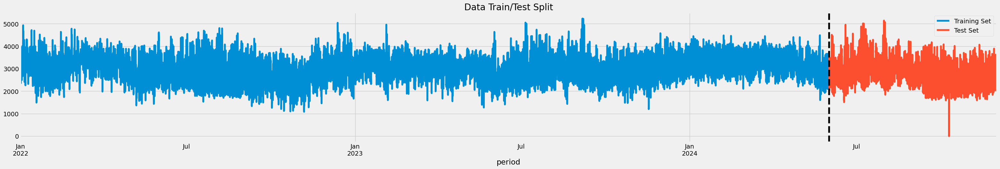

In [ ]:
train = df.loc[df.index < '06-01-2024']
test = df.loc[df.index >= '06-01-2024']

fig, ax = plt.subplots(figsize=(35, 5))
train['value'].plot(ax=ax, label='Training Set', title='Data Train/Test Split')
test['value'].plot(ax=ax, label='Test Set')
ax.axvline('06-01-2024', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

In [ ]:
print("Train Set:")
print(train.shape)

print("\nTest Set:")
print(test.shape)

Train Set:
(21168, 18)

Test Set:
(4393, 18)


In [ ]:
df.columns

Index(['value', 'Day sin', 'Day cos', 'Year sin', 'Year cos', 'Hour sin',
       'Hour cos', 'Minute sin', 'Minute cos', 'Month sin', 'Month cos',
       'rolling_mean_3h', 'rolling_std_3h', 'rolling_mean_24h',
       'rolling_std_24h', 'lag_1', 'lag_2', 'lag_3'],
      dtype='object')

In [ ]:
FEATURES = ['Day sin', 'Day cos', 'Year sin', 'Year cos', 'Hour sin',
       'Hour cos', 'Minute sin', 'Minute cos', 'Month sin', 'Month cos',
       'rolling_mean_3h', 'rolling_std_3h', 'rolling_mean_24h',
       'rolling_std_24h', 'lag_1', 'lag_2', 'lag_3']
TARGET = 'value'

X_train = train[FEATURES]
y_train = train[TARGET]

X_test = test[FEATURES]
y_test = test[TARGET]

In [ ]:
X_train.shape,X_test.shape, y_train.shape,y_test.shape

((21168, 17), (4393, 17), (21168,), (4393,))

In [ ]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
reg = xgb.XGBRegressor(
    n_estimators=1000,
    learning_rate=0.03,
    max_depth=5,
    colsample_bytree=0.7,
    min_child_weight=5,
    reg_alpha=1,
    reg_lambda=1,
    gamma=1,
    early_stopping_rounds=5
)

reg.fit(
    X_train, y_train,
    eval_set=[(X_train, y_train), (X_test, y_test)],
    verbose=100
) 

[0]	validation_0-rmse:600.83405	validation_1-rmse:650.91986
[100]	validation_0-rmse:105.20042	validation_1-rmse:116.50744
[200]	validation_0-rmse:78.21559	validation_1-rmse:91.70079
[300]	validation_0-rmse:66.20958	validation_1-rmse:83.27348
[400]	validation_0-rmse:57.15524	validation_1-rmse:76.97079
[500]	validation_0-rmse:50.39856	validation_1-rmse:72.34418
[600]	validation_0-rmse:45.27854	validation_1-rmse:69.15952
[700]	validation_0-rmse:41.39956	validation_1-rmse:66.67514
[800]	validation_0-rmse:38.20278	validation_1-rmse:64.70445
[900]	validation_0-rmse:35.42843	validation_1-rmse:63.13522
[999]	validation_0-rmse:33.03137	validation_1-rmse:61.65337


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.7, device=None, early_stopping_rounds=5,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=1, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.03, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=5, max_leaves=None,
             min_child_weight=5, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=1000, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

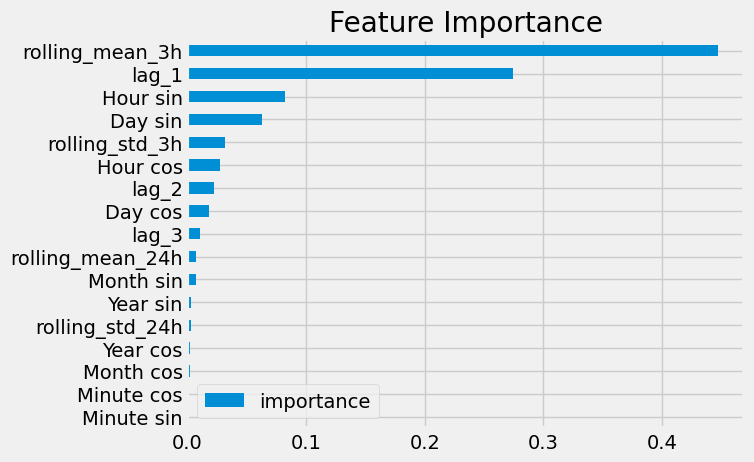

In [ ]:
fi = pd.DataFrame(
    reg.feature_importances_,
    index=reg.feature_names_in_,
    columns=['importance']
)
fi.sort_values('importance').plot(kind='barh', title='Feature Importance')
plt.show()

In [ ]:
test.head()

,value,Day sin,Day cos,Year sin,Year cos,Hour sin,Hour cos,Minute sin,Minute cos,Month sin,Month cos,rolling_mean_3h,rolling_std_3h,rolling_mean_24h,rolling_std_24h,lag_1,lag_2,lag_3,prediction
period,,,,,,,,,,,,,,,,,,,
2024-06-01 00:00:00,3788,-1.539111e-11,1.000000,0.504156,-0.863612,0.000000,1.000000,0.0,1.0,1.224647e-16,-1.0,3634.333333,155.532419,2986.500000,465.765942,3638.0,3477.0,3191.0,3724.239746
2024-06-01 01:00:00,3714,2.588190e-01,0.965926,0.503537,-0.863974,0.258819,0.965926,0.0,1.0,1.224647e-16,-1.0,3713.333333,75.002222,2990.875000,472.314497,3788.0,3638.0,3477.0,3718.581055
2024-06-01 02:00:00,3520,5.000000e-01,0.866025,0.502918,-0.864334,0.500000,0.866025,0.0,1.0,1.224647e-16,-1.0,3674.000000,138.405202,2990.958333,472.411711,3714.0,3788.0,3638.0,3554.348633
2024-06-01 03:00:00,3288,7.071068e-01,0.707107,0.502298,-0.864695,0.707107,0.707107,0.0,1.0,1.224647e-16,-1.0,3507.333333,213.282286,2992.041667,473.089612,3520.0,3714.0,3788.0,3283.912842
2024-06-01 04:00:00,2993,8.660254e-01,0.500000,0.501678,-0.865054,0.866025,0.500000,0.0,1.0,1.224647e-16,-1.0,3267.000000,264.126863,2989.666667,472.929048,3288.0,3520.0,3714.0,2951.783203


/tmp/ipykernel_21975/339363557.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['prediction'] = y_pred_df['prediction']


                      prediction
period                          
2024-06-01 00:00:00  3724.239746
2024-06-01 01:00:00  3718.581055
2024-06-01 02:00:00  3554.348633
2024-06-01 03:00:00  3283.912842
2024-06-01 04:00:00  2951.783203


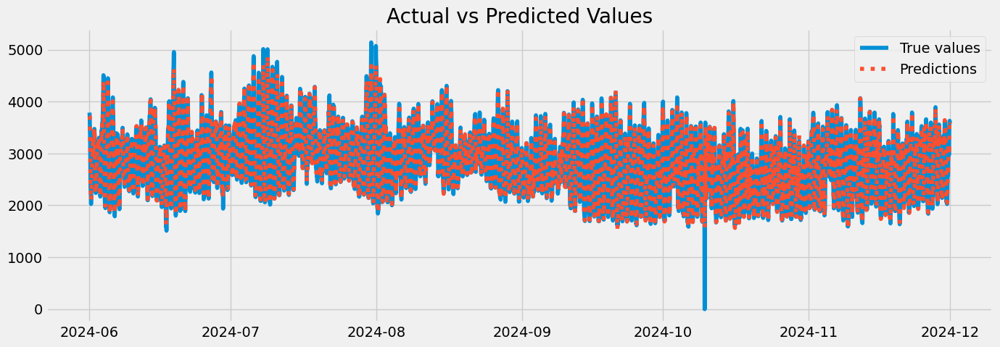

In [ ]:
# Make predictions on the test set
y_pred_test = reg.predict(X_test)
# Make predictions on the train set (optional but useful for model comparison)
y_pred_train = reg.predict(X_train) 
# Create a DataFrame for predictions with proper index alignment
y_pred_df = pd.DataFrame(y_pred_test, index=X_test.index, columns=['prediction'])

# Ensure the index alignment and add the prediction column to the test DataFrame
test['prediction'] = y_pred_df['prediction']

# Display the predictions
print(test[['prediction']].head())

# Plot actual vs predicted values
plt.figure(figsize=(15, 5))
plt.plot(test[TARGET], label='True values')
plt.plot(test['prediction'], label='Predictions', linestyle='dotted')
plt.legend()
plt.title('Actual vs Predicted Values')
plt.show()


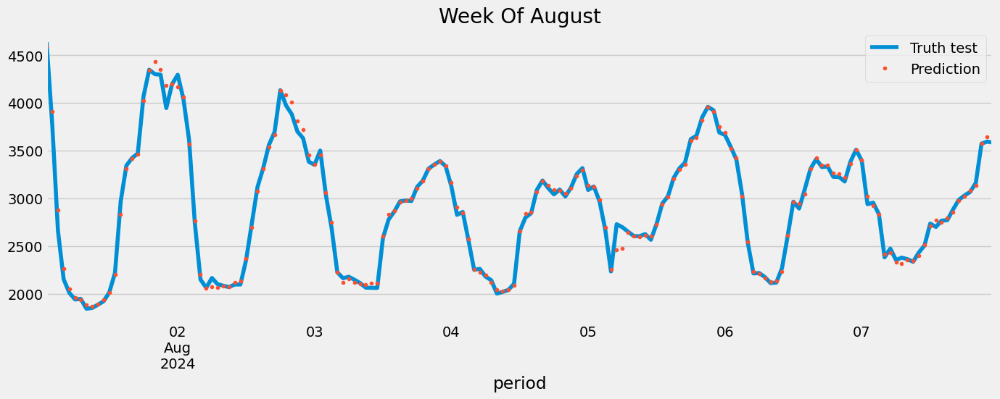

In [ ]:
ax = test.loc[(test.index > '08-01-2024') & (test.index < '08-08-2024')]['value'] \
    .plot(figsize=(15, 5), title='Week Of August')
test.loc[(test.index > '08-01-2024') & (test.index < '08-08-2024')]['prediction'] \
    .plot(style='.')
plt.legend(['Truth test','Prediction'])
plt.show()

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
# Calculate RMSE, MAE, and MSE for the train set
rmse_train = np.sqrt(mean_squared_error(y_train, y_pred_train))
mae_train = mean_absolute_error(y_train, y_pred_train)
mse_train = mean_squared_error(y_train, y_pred_train)
r2_train = r2_score(y_train, y_pred_train)
# Print the metrics
# Calculate RMSE, MAE, and MSE for the test set
rmse_test = np.sqrt(mean_squared_error(y_test, y_pred_test))
mae_test = mean_absolute_error(y_test, y_pred_test)
mse_test = mean_squared_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)
# Print the metrics
print(f"Train RMSE: {rmse_train:.4f}")
print(f"Train MAE: {mae_train:.4f}")
print(f"Train MSE: {mse_train:.4f}")
print(f"Test RMSE: {rmse_test:.4f}")
print(f"Test MAE: {mae_test:.4f}")
print(f"Test MSE: {mse_test:.4f}")
print(f"Train R2: {r2_train:.4f}")
print(f"Test R2: {r2_test:.4f}")

Train RMSE: 33.0432
Train MAE: 23.5319
Train MSE: 1091.8503
Test RMSE: 61.6488
Test MAE: 30.6254
Test MSE: 3800.5774
Train R2: 0.9971
Test R2: 0.9903


### LSTM

In [ ]:
import numpy as np

def df_to_X_y(df, window_size=24):  # Default to 24 for daily patterns
    """
    Converts a DataFrame into X and y datasets for time series modeling.

    Parameters:
        df (pd.DataFrame): The input DataFrame. The target column should be the first column.
        window_size (int): The number of time steps to include in each input sequence.

    Returns:
        X (np.ndarray): Input features of shape (n_samples, window_size, n_features).
        y (np.ndarray): Target values of shape (n_samples,).
    """
    df_as_np = df.to_numpy()
    X = []
    y = []

    for i in range(len(df_as_np) - window_size):
        # Use all columns for X
        row = df_as_np[i:i + window_size]
        X.append(row)
        # Only use the target column ('value') for y
        label = df_as_np[i + window_size][0]  # Target value
        y.append(label)

    return np.array(X), np.array(y)

FEATURES, TARGET = df_to_X_y(df, window_size=19)
print("X shape:", FEATURES.shape)  # Should be (n_samples, window_size, n_features)
print("y shape:", TARGET.shape)  # Should be (n_samples,)

X shape: (25542, 19, 18)
y shape: (25542,)


In [ ]:
# Create limits to divide the trainging, validation and test sets
training_limit = int(len(FEATURES) * 0.7)
print(f'training_limit: {training_limit}')

rest = len(FEATURES)-training_limit
print(f'remaining: {rest}')

validation_limit = int(rest*0.4)
print(f'validation_limit: {validation_limit}')

training_limit: 17879
remaining: 7663
validation_limit: 3065


In [ ]:
# Generating training, validation and test sets
X_train, y_train = FEATURES[:training_limit], TARGET[:training_limit]
X_val, y_val = FEATURES[training_limit:(training_limit+validation_limit)], TARGET[training_limit:(training_limit+validation_limit)]
X_test, y_test = FEATURES[(training_limit+validation_limit):], TARGET[(training_limit+validation_limit):]

X_train.shape, y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape

((17879, 19, 18), (17879,), (3065, 19, 18), (3065,), (4598, 19, 18), (4598,))

In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Initialize the scaler
x_scaler = MinMaxScaler()

# Reshape X_train2, X_val2, and X_test2 to 2D arrays as MinMaxScaler expects 2D input
X_train_reshaped = X_train.reshape(-1, X_train.shape[-1])
X_val_reshaped = X_val.reshape(-1, X_val.shape[-1])
X_test_reshaped = X_test.reshape(-1, X_test.shape[-1])

# Fit the scaler on the training data and transform it
X_train_scaled = x_scaler.fit_transform(X_train_reshaped)

# Transform the validation and test data using the same scaler
X_val_scaled = x_scaler.transform(X_val_reshaped)
X_test_scaled = x_scaler.transform(X_test_reshaped)

# Reshape the scaled data back to the original shape (if needed)
X_train_scaled = X_train_scaled.reshape(X_train.shape)
X_val_scaled = X_val_scaled.reshape(X_val.shape)
X_test_scaled = X_test_scaled.reshape(X_test.shape)

# To scale y values (if necessary), you can apply MinMaxScaler to y_train2, y_val2, and y_test2
y_scaler = MinMaxScaler()

# Reshape y arrays to 2D for scaling
y_train_reshaped = y_train.reshape(-1, 1)
y_val_reshaped = y_val.reshape(-1, 1)
y_test_reshaped = y_test.reshape(-1, 1)

# Fit the y_scaler on the training labels and transform
y_train_scaled = y_scaler.fit_transform(y_train_reshaped)

# Transform the validation and test labels using the same y_scaler
y_val_scaled = y_scaler.transform(y_val_reshaped)
y_test_scaled = y_scaler.transform(y_test_reshaped)

# Output the scaled data shapes
X_train_scaled.shape, y_train_scaled.shape, X_val_scaled.shape, y_val_scaled.shape, X_test_scaled.shape, y_test_scaled.shape


((17879, 19, 18),
 (17879, 1),
 (3065, 19, 18),
 (3065, 1),
 (4598, 19, 18),
 (4598, 1))

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.metrics import RootMeanSquaredError
from tensorflow.keras.optimizers import Adam

lstm = Sequential()
lstm.add(InputLayer((19, 18)))
lstm.add(LSTM(64))
lstm.add(Dense(128))
lstm.add(Dense(64))
lstm.add(Dense(64))
lstm.add(Dense(64))
lstm.add(Dropout(0.3))
lstm.add(Dense(64))
lstm.add(Dropout(0.3))
lstm.add(Dense(16))
lstm.add(Dense(8, 'relu'))
lstm.add(Dense(1, 'linear'))

lstm.summary()
cp_lstm = ModelCheckpoint('lstm/lstm.keras', save_best_only=True)
lstm.compile(loss=MeanSquaredError(), optimizer=Adam(learning_rate=0.0001), metrics=[RootMeanSquaredError()])
lstm.fit(X_train_scaled, y_train_scaled, validation_data=(X_val_scaled, y_val_scaled), epochs=50, callbacks=[cp_lstm])

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm_1 (LSTM)                   │ (None, 64)             │        21,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 128)            │         8,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 16)             │         1,040 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 8)              │           136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 1)              │             9 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 51,489 (201.13 KB)

 Trainable params: 51,489 (201.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50


2024-12-22 12:40:07.839173: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 24458472 exceeds 10% of free system memory.


559/559 ━━━━━━━━━━━━━━━━━━━━ 27s 15ms/step - loss: 0.0552 - root_mean_squared_error: 0.2222 - val_loss: 0.0063 - val_root_mean_squared_error: 0.0792
Epoch 2/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0104 - root_mean_squared_error: 0.1018 - val_loss: 0.0053 - val_root_mean_squared_error: 0.0731
Epoch 3/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0068 - root_mean_squared_error: 0.0822 - val_loss: 0.0031 - val_root_mean_squared_error: 0.0558
Epoch 4/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 11s 19ms/step - loss: 0.0051 - root_mean_squared_error: 0.0715 - val_loss: 0.0023 - val_root_mean_squared_error: 0.0480
Epoch 5/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0042 - root_mean_squared_error: 0.0648 - val_loss: 0.0020 - val_root_mean_squared_error: 0.0453
Epoch 6/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.0036 - root_mean_squared_error: 0.0600 - val_loss: 0.0019 - val_root_mean_squared_error: 0.0439
Epoch 7/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 12s 21ms/step -

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def evaluate_model(model, X_test, y_test, scaler, plot_range=100):
    """
    Evaluate a model's performance and visualize predictions vs actual values.

    Parameters:
        model: Trained model to evaluate.
        X_test_scaled: Scaled test input features (3D array for LSTM models).
        y_test_scaled: Scaled test labels.
        scaler: Fitted scaler object used for scaling the labels.
        plot_range: Number of points to display in the plot.

    Returns:
        results_df: DataFrame containing predictions and actual values.
        metrics: Dictionary containing MAE, MSE, RMSE, and R².
    """
    # Step 1: Make predictions using the scaled test data
    predictions = model.predict(X_test).flatten()

    # Step 2: Inverse transform predictions and actuals to original scale
    predictions_rescaled = scaler.inverse_transform(predictions.reshape(-1, 1)).flatten()
    actuals_rescaled = scaler.inverse_transform(y_test).flatten()

    # Step 3: Create a DataFrame with predictions and actuals
    results_df = pd.DataFrame({
        'Predictions': predictions_rescaled,
        'Actuals': actuals_rescaled
    })

    # Step 4: Calculate evaluation metrics
    mae = mean_absolute_error(actuals_rescaled, predictions_rescaled)
    mse = mean_squared_error(actuals_rescaled, predictions_rescaled)
    rmse = np.sqrt(mse)
    r2 = r2_score(actuals_rescaled, predictions_rescaled)

    metrics = {
        'Mean Absolute Error (MAE)': mae,
        'Mean Squared Error (MSE)': mse,
        'Root Mean Squared Error (RMSE)': rmse,
        'R² Score': r2
    } 
    print("Evaluation Metrics:")
    for metric, value in metrics.items():
        print(f"{metric}: {value}")
        
    plt.figure(figsize=(15, 5))
    plt.plot(results_df['Actuals'][:plot_range], label='Actuals', linestyle='-', color='blue', markersize=10)
    plt.plot(results_df['Predictions'][:plot_range], label='Predictions', linestyle='--', color='red', markersize=10)
    plt.title('Actuals vs Predictions')
    plt.xlabel('Sample Index')
    plt.ylabel('Value')
    plt.legend()
    plt.show()
 
    return results_df

559/559 ━━━━━━━━━━━━━━━━━━━━ 11s 14ms/step
Evaluation Metrics:
Mean Absolute Error (MAE): 129.50406608366046
Mean Squared Error (MSE): 29423.00193743116
Root Mean Squared Error (RMSE): 171.53134389210376
R² Score: 0.924245975920091


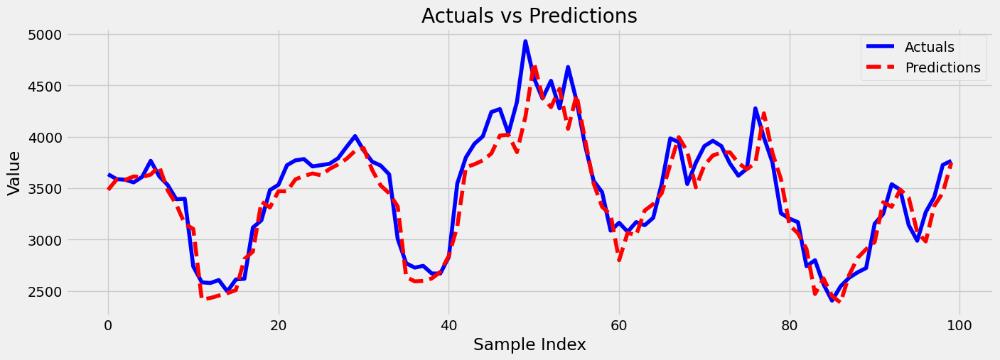

,Predictions,Actuals
0,3483.924805,3636.0
1,3585.331299,3589.0
2,3581.362793,3583.0
3,3615.101074,3557.0
4,3608.078125,3611.0
...,...,...
17874,3350.785156,3718.0
17875,3761.545898,3770.0
17876,3642.342529,3785.0
17877,3647.759766,3917.0


In [ ]:
lstm_train_metrics = evaluate_model(lstm, X_train_scaled, y_train_scaled, y_scaler, plot_range=100)
lstm_train_metrics

96/96 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


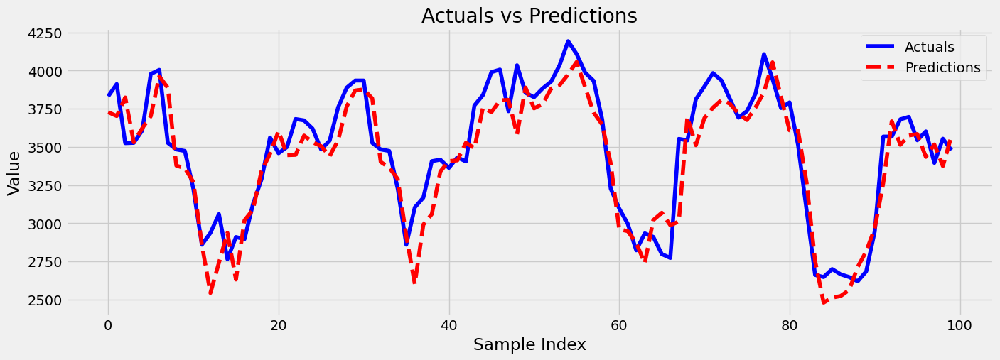

Evaluation Metrics:
Mean Absolute Error (MAE): 132.07870532186735
Mean Squared Error (MSE): 27574.90788968298
Root Mean Squared Error (RMSE): 166.05694170880957
R² Score: 0.8985739538830819


,Predictions,Actuals
0,3726.891846,3831.0
1,3701.731445,3911.0
2,3823.121582,3524.0
3,3529.823486,3526.0
4,3622.075439,3607.0
...,...,...
3060,2257.974121,2302.0
3061,2127.738037,2290.0
3062,2130.970215,2253.0
3063,2242.360596,2258.0


In [ ]:
lstm_val_metrics = evaluate_model(lstm, X_val_scaled, y_val_scaled, y_scaler, plot_range=100)
lstm_val_metrics

144/144 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


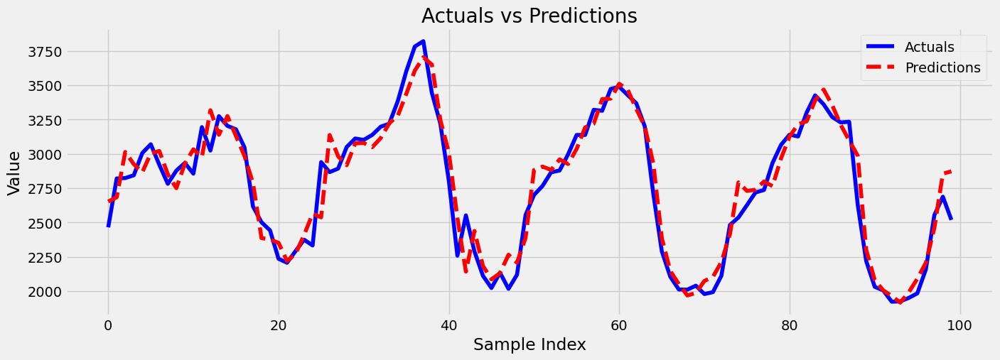

Evaluation Metrics:
Mean Absolute Error (MAE): 120.15509534971048
Mean Squared Error (MSE): 27652.529745151558
Root Mean Squared Error (RMSE): 166.29049806032683
R² Score: 0.9280907360948113


,Predictions,Actuals
0,2652.565186,2465.0
1,2683.968994,2821.0
2,3013.814453,2824.0
3,2925.540039,2844.0
4,2865.458496,3006.0
...,...,...
4593,3034.242676,2972.0
4594,3090.609863,3387.0
4595,3494.901855,3591.0
4596,3616.079346,3630.0


In [ ]:
lstm_test_metrics= evaluate_model(lstm, X_test_scaled, y_test_scaled, y_scaler, plot_range=100)
lstm_test_metrics

In [ ]:
def evaluate_model_full(model, X_train, y_train, X_val, y_val, X_test, y_test, scaler, plot_range=1000):
    """
    Evaluate a model on train, validation, and test sets, and visualize predictions vs actual values.

    Parameters:
        model: Trained model to evaluate.
        X_train, y_train: Training data and labels.
        X_val, y_val: Validation data and labels.
        X_test, y_test: Test data and labels.
        scaler: Fitted scaler object used for scaling the labels.
        plot_range: Number of points to display in the plot for combined data.

    Returns:
        combined_metrics_df: DataFrame containing predictions and actual values for all datasets.
        combined_metrics: Dictionary containing MAE, MSE, RMSE, and R² for combined data.
    """
    def evaluate_single_set(X, y):
        predictions_scaled = model.predict(X).flatten()
        predictions_rescaled = scaler.inverse_transform(predictions_scaled.reshape(-1, 1)).flatten()
        actuals_rescaled = scaler.inverse_transform(y).flatten()

        # Debugging outputs
        print(f"Predictions shape: {predictions_rescaled.shape}, Actuals shape: {actuals_rescaled.shape}")

        return predictions_rescaled, actuals_rescaled
    # Step 1: Evaluate predictions on each set
    train_preds, train_actuals = evaluate_single_set(X_train, y_train)
    val_preds, val_actuals = evaluate_single_set(X_val, y_val)
    test_preds, test_actuals = evaluate_single_set(X_test, y_test)

    print(f"Length of train_preds: {len(train_preds)}, train_actuals: {len(train_actuals)}")
    print(f"Length of val_preds: {len(val_preds)}, val_actuals: {len(val_actuals)}")
    print(f"Length of test_preds: {len(test_preds)}, test_actuals: {len(test_actuals)}")

    # Step 2: Combine predictions and actuals
    all_predictions = np.concatenate([train_preds, val_preds, test_preds])
    all_actuals = np.concatenate([train_actuals, val_actuals, test_actuals]) # Include test_actuals in all_actuals
    data_labels = (['Train'] * len(train_preds) +
                   ['Validation'] * len(val_preds) +
                   ['Test'] * len(test_preds))

    combined_metrics_df = pd.DataFrame({
        'Set': data_labels,
        'Predictions': all_predictions,
        'Actuals': all_actuals
    })

    # Step 3: Compute combined metrics
    mae = mean_absolute_error(all_actuals, all_predictions)
    mse = mean_squared_error(all_actuals, all_predictions)
    rmse = np.sqrt(mse)
    r2 = r2_score(all_actuals, all_predictions)

    combined_metrics = {
        'Mean Absolute Error (MAE)': mae,
        'Mean Squared Error (MSE)': mse,
        'Root Mean Squared Error (RMSE)': rmse,
        'R² Score': r2
    }

    # Step 4: Plot combined metrics
    plt.figure(figsize=(15, 5))
    plt.plot(all_actuals[:plot_range], label='Actuals', linestyle='-', color='blue')
    plt.plot(all_predictions[:plot_range], label='Predictions', linestyle='--', color='red')
    plt.title('Combined Actuals vs Predictions')
    plt.xlabel('Sample Index')
    plt.ylabel('Value')
    plt.legend()
    plt.show()

    # Step 5: Print metrics
    print("Combined Evaluation Metrics:")
    for metric, value in combined_metrics.items():
        print(f"{metric}: {value}")

    return combined_metrics_df, combined_metrics

559/559 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
Predictions shape: (17879,), Actuals shape: (17879,)
96/96 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Predictions shape: (3065,), Actuals shape: (3065,)
144/144 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
Predictions shape: (4598,), Actuals shape: (4598,)
Length of train_preds: 17879, train_actuals: 17879
Length of val_preds: 3065, val_actuals: 3065
Length of test_preds: 4598, test_actuals: 4598


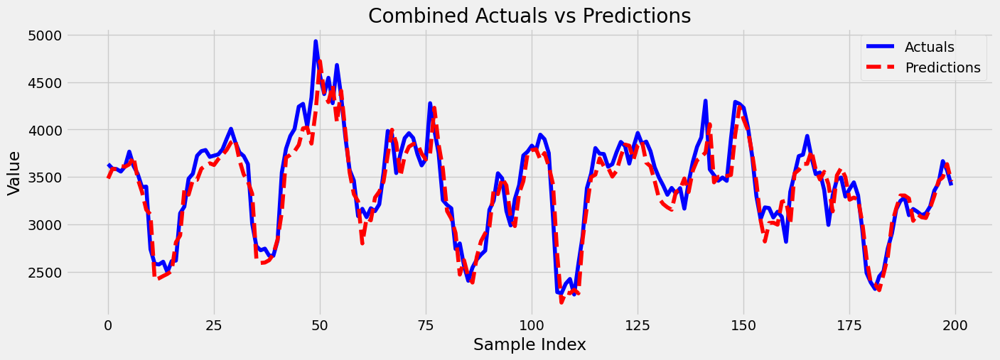

Combined Evaluation Metrics:
Mean Absolute Error (MAE): 128.13004297781137
Mean Squared Error (MSE): 28882.518052204872
Root Mean Squared Error (RMSE): 169.9485747283715
R² Score: 0.9262962103122728
     Set  Predictions  Actuals
0  Train  3483.924805   3636.0
1  Train  3585.331299   3589.0
2  Train  3581.362793   3583.0
3  Train  3615.101074   3557.0
4  Train  3608.078125   3611.0
(25542, 3)


In [ ]:
# Call the function to evaluate the model on train, validation, and test sets
combined_metrics_lstm, combined_metrics = evaluate_model_full(
    lstm,
    X_train_scaled, y_train_scaled,
    X_val_scaled, y_val_scaled,
    X_test_scaled, y_test_scaled,
    y_scaler,
    plot_range=200
)
# View combined metrics
print(combined_metrics_lstm.head())
print(combined_metrics_lstm.shape)

### GRU

In [ ]:
gru = Sequential()
gru.add(InputLayer((19, 18)))
gru.add(GRU(64))
gru.add(Dense(128))
gru.add(Dense(64))
gru.add(Dense(64))
gru.add(Dense(64))
gru.add(Dropout(0.3))
gru.add(Dense(64))
gru.add(Dropout(0.3))
gru.add(Dense(16))
gru.add(Flatten())
gru.add(Dense(8, 'relu'))
gru.add(Dense(1, 'linear'))

gru.summary()
cp_gru = ModelCheckpoint('gru/gru.keras', save_best_only=True)
gru.compile(loss=MeanSquaredError(), optimizer=Adam(learning_rate=0.0001), metrics=[RootMeanSquaredError()])

gru.fit(X_train_scaled, y_train_scaled, validation_data=(X_val_scaled, y_val_scaled), epochs=50, callbacks=[cp_gru])

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ gru_1 (GRU)                     │ (None, 64)             │        16,128 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 128)            │         8,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 16)             │         1,040 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 8)              │           136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 1)              │             9 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 46,369 (181.13 KB)

 Trainable params: 46,369 (181.13 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 22s 19ms/step - loss: 0.0358 - root_mean_squared_error: 0.1837 - val_loss: 0.0051 - val_root_mean_squared_error: 0.0713
Epoch 2/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 8s 15ms/step - loss: 0.0087 - root_mean_squared_error: 0.0931 - val_loss: 0.0034 - val_root_mean_squared_error: 0.0579
Epoch 3/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 11s 20ms/step - loss: 0.0061 - root_mean_squared_error: 0.0778 - val_loss: 0.0039 - val_root_mean_squared_error: 0.0626
Epoch 4/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.0051 - root_mean_squared_error: 0.0713 - val_loss: 0.0022 - val_root_mean_squared_error: 0.0464
Epoch 5/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.0039 - root_mean_squared_error: 0.0628 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0420
Epoch 6/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0035 - root_mean_squared_error: 0.0595 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0425
Epoch 7/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 7s 1

559/559 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step


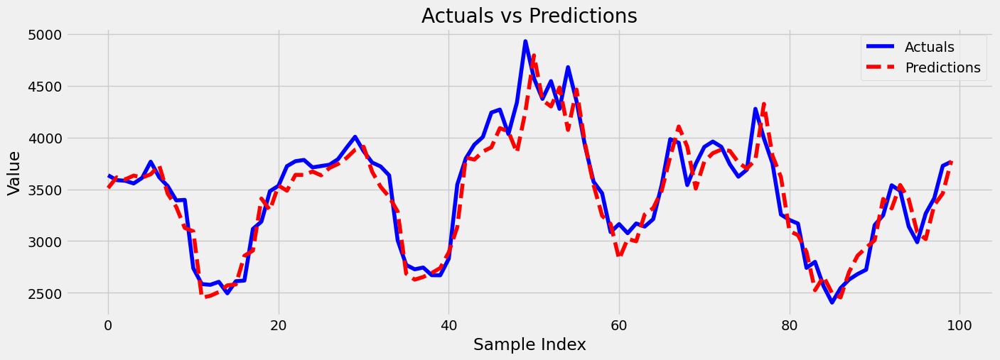

Evaluation Metrics:
Mean Absolute Error (MAE): 128.07490701791164
Mean Squared Error (MSE): 28845.085619933634
Root Mean Squared Error (RMSE): 169.83841031973196
R² Score: 0.925733909976751


,Predictions,Actuals
0,3512.992920,3636.0
1,3615.608154,3589.0
2,3595.765137,3583.0
3,3632.792480,3557.0
4,3613.236572,3611.0
...,...,...
17874,3379.217773,3718.0
17875,3857.214355,3770.0
17876,3682.424072,3785.0
17877,3716.725830,3917.0


In [ ]:
gru_train_metrics = evaluate_model(gru, X_train_scaled, y_train_scaled, y_scaler, plot_range=100)
gru_train_metrics

 1/96 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step

96/96 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


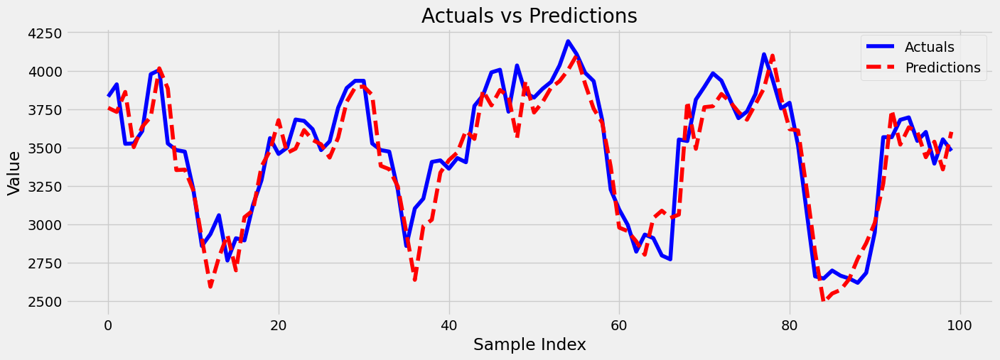

Evaluation Metrics:
Mean Absolute Error (MAE): 120.37857687920575
Mean Squared Error (MSE): 23978.625463625114
Root Mean Squared Error (RMSE): 154.85033246210713
R² Score: 0.9118018025001676


,Predictions,Actuals
0,3758.338135,3831.0
1,3731.356201,3911.0
2,3861.599121,3524.0
3,3502.176270,3526.0
4,3634.907959,3607.0
...,...,...
3060,2254.385986,2302.0
3061,2115.315430,2290.0
3062,2115.953857,2253.0
3063,2265.455566,2258.0


In [ ]:
gru_val_metrics = evaluate_model(gru, X_val_scaled, y_val_scaled, y_scaler, plot_range=100)
gru_val_metrics

144/144 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


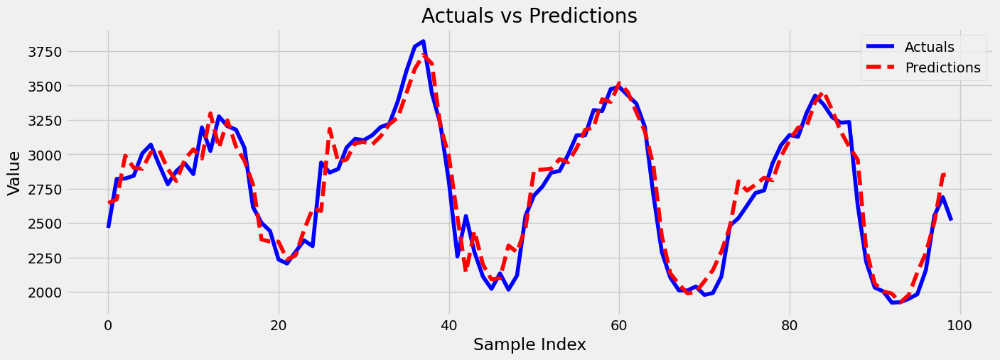

Evaluation Metrics:
Mean Absolute Error (MAE): 122.56610399456116
Mean Squared Error (MSE): 28192.1399373934
Root Mean Squared Error (RMSE): 167.90515161064417
R² Score: 0.9266875020298827


,Predictions,Actuals
0,2645.606689,2465.0
1,2672.759033,2821.0
2,2989.858154,2824.0
3,2901.773193,2844.0
4,2894.413818,3006.0
...,...,...
4593,3047.500000,2972.0
4594,3089.401855,3387.0
4595,3512.186279,3591.0
4596,3609.544189,3630.0


In [ ]:
gru_test_metrics = evaluate_model(gru, X_test_scaled, y_test_scaled, y_scaler, plot_range=100)
gru_test_metrics

559/559 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
Predictions shape: (17879,), Actuals shape: (17879,)
96/96 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Predictions shape: (3065,), Actuals shape: (3065,)
144/144 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
Predictions shape: (4598,), Actuals shape: (4598,)
Length of train_preds: 17879, train_actuals: 17879
Length of val_preds: 3065, val_actuals: 3065
Length of test_preds: 4598, test_actuals: 4598


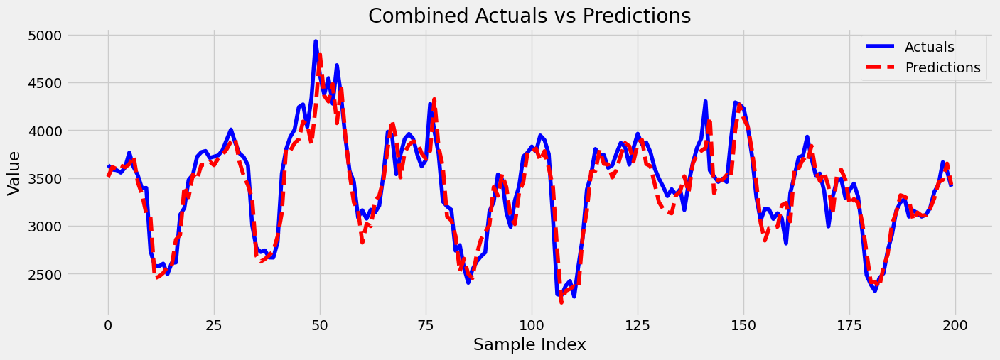

Combined Evaluation Metrics:
Mean Absolute Error (MAE): 126.15968001233263
Mean Squared Error (MSE): 28143.5765514423
Root Mean Squared Error (RMSE): 167.76047374588063
R² Score: 0.928181876543496
     Set  Predictions  Actuals
0  Train  3512.992920   3636.0
1  Train  3615.608154   3589.0
2  Train  3595.765137   3583.0
3  Train  3632.792480   3557.0
4  Train  3613.236572   3611.0
(25542, 3)


In [ ]:
# Call the function to evaluate the model on train, validation, and test sets
combined_metrics_gru, combined_metrics = evaluate_model_full(
    gru,
    X_train_scaled, y_train_scaled,
    X_val_scaled, y_val_scaled,
    X_test_scaled, y_test_scaled,
    y_scaler,
    plot_range=200
)
# View combined metrics
print(combined_metrics_gru.head())
print(combined_metrics_gru.shape)

### CNN 1D

In [ ]:
conv = Sequential()
conv.add(InputLayer((19,18)))
conv.add(Conv1D(64, kernel_size=2))
conv.add(Dense(128))
conv.add(Dense(64))
conv.add(Dense(64))
conv.add(Dense(64))
conv.add(Dropout(0.3))
conv.add(Dense(64))
conv.add(Dropout(0.3))
conv.add(Dense(16))
conv.add(Flatten())
conv.add(Dense(8, 'relu'))
conv.add(Dense(1, 'linear'))

conv.summary()
cp_conv = ModelCheckpoint('conv/conv.keras', save_best_only=True)
conv.compile(loss=MeanSquaredError(), optimizer=Adam(learning_rate=0.0001), metrics=[RootMeanSquaredError()])

conv.fit(X_train_scaled, y_train_scaled, validation_data=(X_val_scaled, y_val_scaled), epochs=50, callbacks=[cp_conv])

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_1 (Conv1D)               │ (None, 18, 64)         │         2,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 18, 128)        │         8,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 18, 64)         │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 18, 64)         │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 18, 64)         │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_10 (Dropout)            │ (None, 18, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 18, 64)         │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 18, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 18, 16)         │         1,040 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 288)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 8)              │         2,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 1)              │             9 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 34,785 (135.88 KB)

 Trainable params: 34,785 (135.88 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 13s 15ms/step - loss: 0.0719 - root_mean_squared_error: 0.2586 - val_loss: 0.0056 - val_root_mean_squared_error: 0.0749
Epoch 2/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0118 - root_mean_squared_error: 0.1088 - val_loss: 0.0042 - val_root_mean_squared_error: 0.0649
Epoch 3/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0082 - root_mean_squared_error: 0.0907 - val_loss: 0.0030 - val_root_mean_squared_error: 0.0549
Epoch 4/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0065 - root_mean_squared_error: 0.0808 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0490
Epoch 5/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0052 - root_mean_squared_error: 0.0718 - val_loss: 0.0024 - val_root_mean_squared_error: 0.0492
Epoch 6/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.0043 - root_mean_squared_error: 0.0657 - val_loss: 0.0018 - val_root_mean_squared_error: 0.0420
Epoch 7/50
559/559 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/ste

559/559 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step
Evaluation Metrics:
Mean Absolute Error (MAE): 134.77434390228237
Mean Squared Error (MSE): 31422.307641450356
Root Mean Squared Error (RMSE): 177.26338494300043
R² Score: 0.9190984572281694


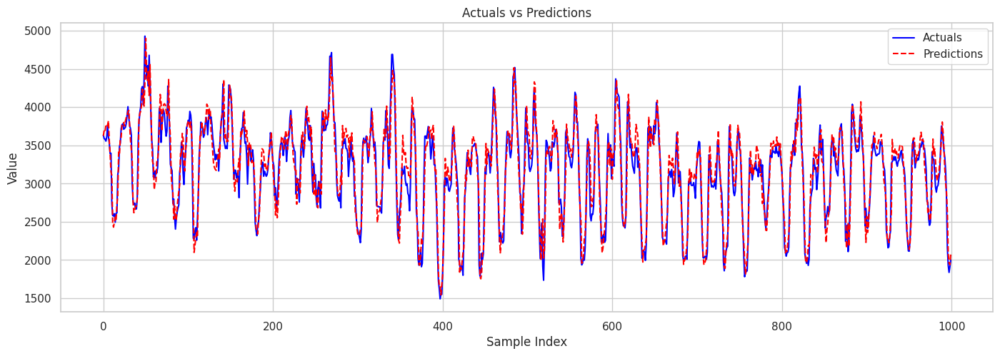

,Predictions,Actuals
0,3624.777832,3636.0
1,3701.032959,3589.0
2,3684.035156,3583.0
3,3765.135498,3557.0
4,3746.218994,3611.0
...,...,...
17874,3391.727783,3718.0
17875,3902.108398,3770.0
17876,3782.224609,3785.0
17877,3821.718262,3917.0


In [ ]:
conv_train_metrics = evaluate_model(conv, X_train_scaled, y_train_scaled, y_scaler, plot_range=1000)
conv_train_metrics

96/96 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Evaluation Metrics:
Mean Absolute Error (MAE): 118.8182296180414
Mean Squared Error (MSE): 23444.142409031338
Root Mean Squared Error (RMSE): 153.11480140414687
R² Score: 0.9137677384576264


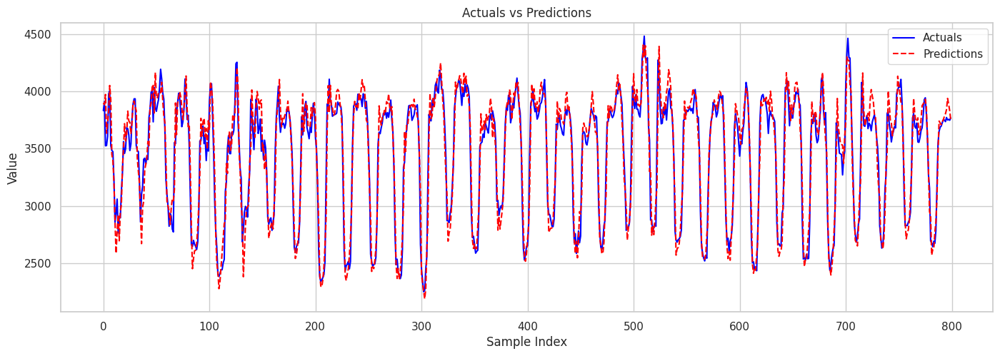

,Predictions,Actuals
0,3898.437744,3831.0
1,3882.889893,3911.0
2,3971.531494,3524.0
3,3633.444092,3526.0
4,3735.857178,3607.0
...,...,...
3060,2159.078613,2302.0
3061,1990.627686,2290.0
3062,2080.913818,2253.0
3063,2175.393311,2258.0


In [ ]:
conv_train_metrics = evaluate_model(conv, X_val_scaled, y_val_scaled, y_scaler, plot_range=800)
conv_train_metrics

144/144 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step
Evaluation Metrics:
Mean Absolute Error (MAE): 126.19718393505838
Mean Squared Error (MSE): 29203.894118595792
Root Mean Squared Error (RMSE): 170.89146882918348
R² Score: 0.9240564769810437


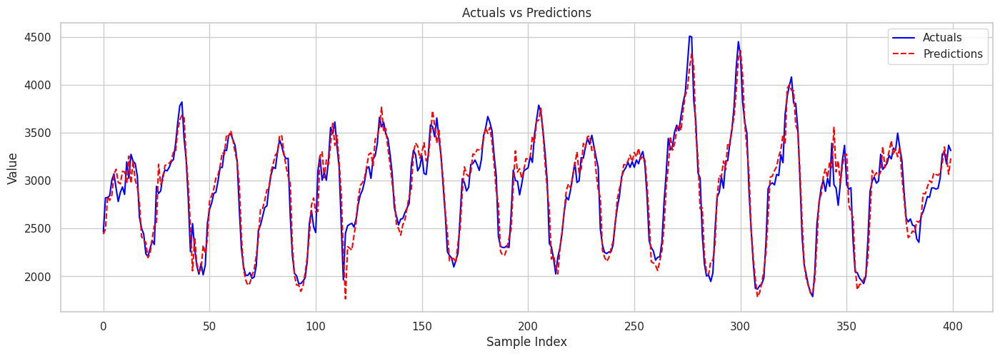

,Predictions,Actuals
0,2441.023193,2465.0
1,2495.362305,2821.0
2,2835.882812,2824.0
3,2794.332520,2844.0
4,2847.999756,3006.0
...,...,...
4593,3081.402100,2972.0
4594,3141.810791,3387.0
4595,3584.333252,3591.0
4596,3660.598877,3630.0


In [ ]:
conv_test_metrics = evaluate_model(conv, X_test_scaled, y_test_scaled, y_scaler, plot_range=400)
conv_test_metrics

559/559 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step
Predictions shape: (17879,), Actuals shape: (17879,)
96/96 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
Predictions shape: (3065,), Actuals shape: (3065,)
144/144 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Predictions shape: (4598,), Actuals shape: (4598,)
Length of train_preds: 17879, train_actuals: 17879
Length of val_preds: 3065, val_actuals: 3065
Length of test_preds: 4598, test_actuals: 4598


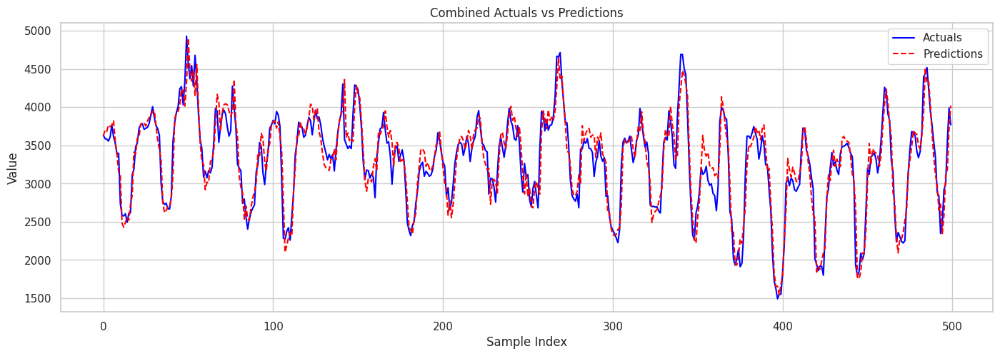

Combined Evaluation Metrics:
Mean Absolute Error (MAE): 131.31559862742156
Mean Squared Error (MSE): 30065.58765807201
Root Mean Squared Error (RMSE): 173.3943126462688
R² Score: 0.9232771967602285
     Set  Predictions  Actuals
0  Train  3624.777832   3636.0
1  Train  3701.032959   3589.0
2  Train  3684.035156   3583.0
3  Train  3765.135498   3557.0
4  Train  3746.218994   3611.0
(25542, 3)


In [ ]:
# Call the function to evaluate the model on train, validation, and test sets
combined_metrics_conv, combined_metrics = evaluate_model_full(
    conv,
    X_train_scaled, y_train_scaled,
    X_val_scaled, y_val_scaled,
    X_test_scaled, y_test_scaled,
    y_scaler,
    plot_range=500
)
# View combined metrics
print(combined_metrics_conv.head())
print(combined_metrics_conv.shape)

### Prophet

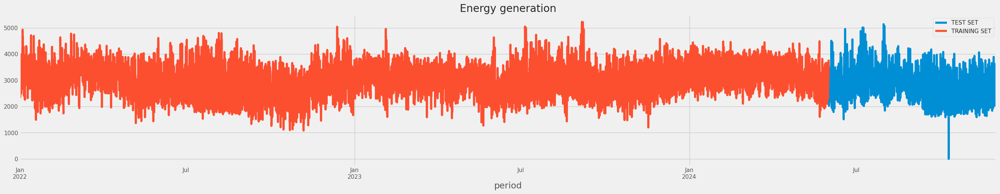

In [ ]:
# Train / Test Split¶
split_date = '1-June-2024'
df_train = df.loc[df.index <= split_date].copy()
df_test = df.loc[df.index > split_date].copy()

# Plot train and test so you can see where we have split
df_test \
    .rename(columns={'value': 'TEST SET'}) \
    .join(df_train.rename(columns={'value': 'TRAINING SET'}),
          how='outer') \
    .plot(figsize=(30, 5), title='Energy generation', style='-', ms=1)
plt.show()

In [ ]:
# Format data for prophet model using ds and y
df_train_prophet = df_train.reset_index() \
    .rename(columns={'period':'ds',
                     'value':'y'})

In [ ]:
%%time
model = Prophet(interval_width=0.95, daily_seasonality=True)
model.fit(df_train_prophet)

18:41:58 - cmdstanpy - INFO - Chain [1] start processing
18:42:32 - cmdstanpy - INFO - Chain [1] done processing


CPU times: user 4.84 s, sys: 1.61 s, total: 6.45 s
Wall time: 41.2 s


In [ ]:
# Predict on test set with model
df_test_prophet = df_test.reset_index() \
    .rename(columns={'period':'ds',
                     'value':'y'})
df_test_forecast = model.predict(df_test_prophet)
df_test_forecast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2024-06-01 01:00:00,3013.127864,2716.014129,4167.632468,3013.127864,3013.127864,394.016554,394.016554,394.016554,515.347190,...,30.147324,30.147324,30.147324,-151.477961,-151.477961,-151.477961,0.0,0.0,0.0,3407.144418
1,2024-06-01 02:00:00,3013.085959,2517.014710,3910.911885,3013.085959,3013.085959,187.705160,187.705160,187.705160,315.383183,...,24.082974,24.082974,24.082974,-151.760996,-151.760996,-151.760996,0.0,0.0,0.0,3200.791119
2,2024-06-01 03:00:00,3013.044054,2240.997039,3565.110450,3013.044054,3013.044054,-102.817625,-102.817625,-102.817625,31.701557,...,17.523915,17.523915,17.523915,-152.043097,-152.043097,-152.043097,0.0,0.0,0.0,2910.226429
3,2024-06-01 04:00:00,3013.002149,1914.466093,3282.290970,3013.002149,3013.002149,-398.780491,-398.780491,-398.780491,-256.946635,...,10.490402,10.490402,10.490402,-152.324259,-152.324259,-152.324259,0.0,0.0,0.0,2614.221657
4,2024-06-01 05:00:00,3012.960244,1711.500689,3039.042050,3012.960244,3012.960244,-635.923054,-635.923054,-635.923054,-486.326387,...,3.007814,3.007814,3.007814,-152.604481,-152.604481,-152.604481,0.0,0.0,0.0,2377.037190
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4387,2024-11-30 20:00:00,2829.290515,1834.967848,4609.938830,1769.824780,4178.145569,255.773016,255.773016,255.773016,347.167941,...,-132.730359,-132.730359,-132.730359,41.335433,41.335433,41.335433,0.0,0.0,0.0,3085.063531
4388,2024-11-30 21:00:00,2829.248610,1861.112901,4571.888750,1769.525422,4178.477199,307.462974,307.462974,307.462974,406.434605,...,-140.736608,-140.736608,-140.736608,41.764978,41.764978,41.764978,0.0,0.0,0.0,3136.711584
4389,2024-11-30 22:00:00,2829.206705,1957.888496,4615.528988,1769.226064,4178.808829,375.770735,375.770735,375.770735,481.839394,...,-148.261336,-148.261336,-148.261336,42.192678,42.192678,42.192678,0.0,0.0,0.0,3204.977440
4390,2024-11-30 23:00:00,2829.164800,2011.164196,4667.132533,1768.926706,4179.140459,446.895926,446.895926,446.895926,559.525195,...,-155.247805,-155.247805,-155.247805,42.618537,42.618537,42.618537,0.0,0.0,0.0,3276.060727


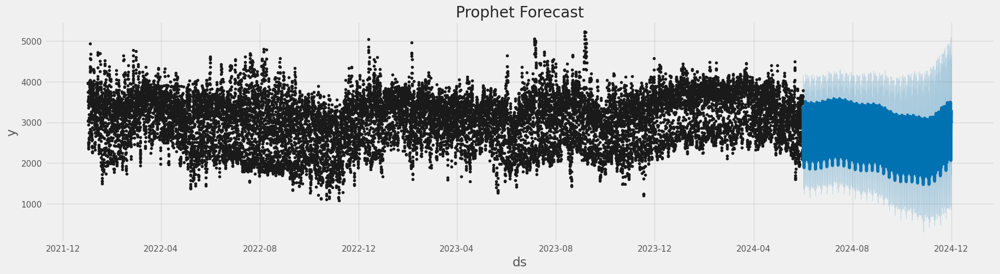

In [ ]:
fig, ax = plt.subplots(figsize=(20, 5))
fig = model.plot(df_test_forecast , ax=ax)
ax.set_title('Prophet Forecast')
plt.show()

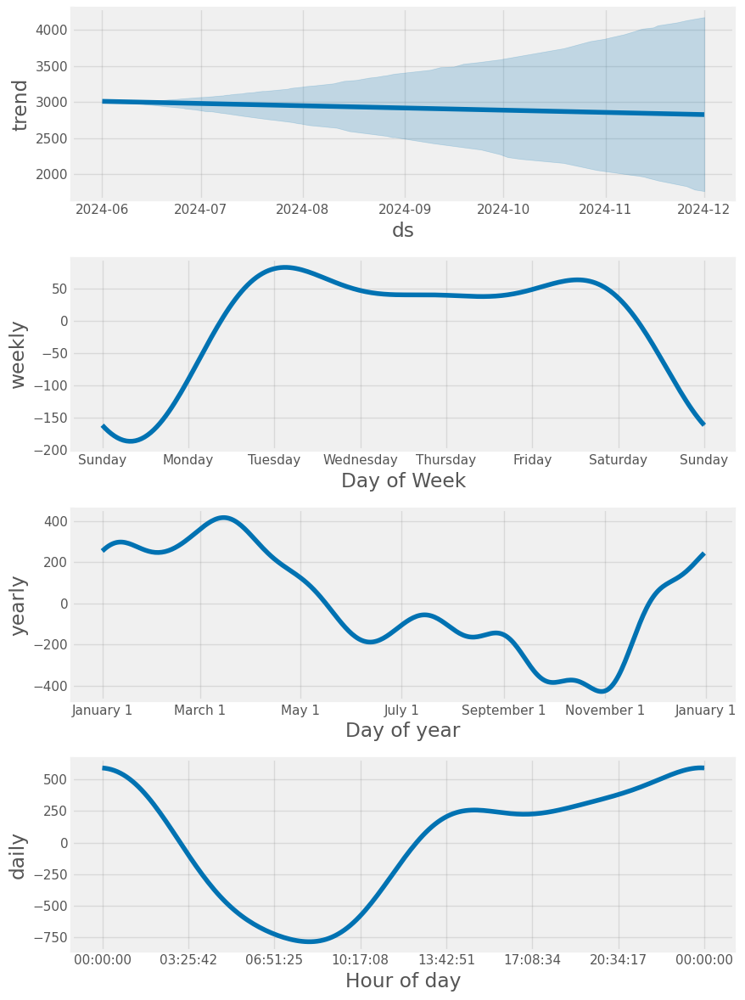

In [ ]:
fig = model.plot_components(df_test_forecast)
plt.show()

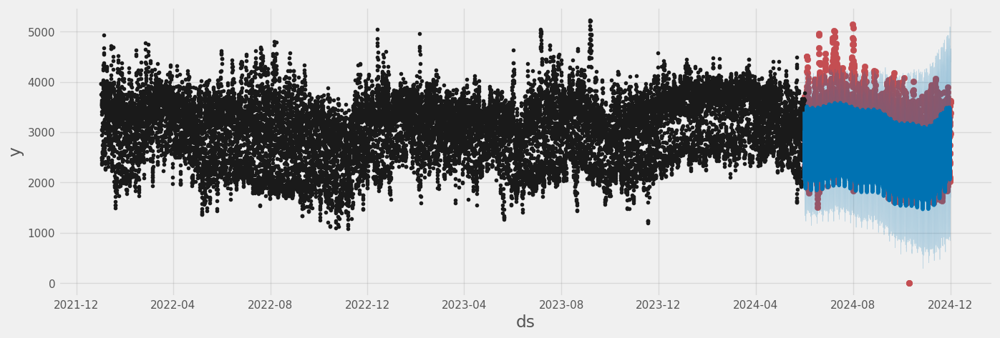

In [ ]:
# Compare Forecast to Actuals

# Plot the forecast with the actuals
f, ax = plt.subplots(figsize=(15, 5))
ax.scatter(df_test.index, df_test['value'], color='r')
fig = model.plot(df_test_forecast, ax=ax)

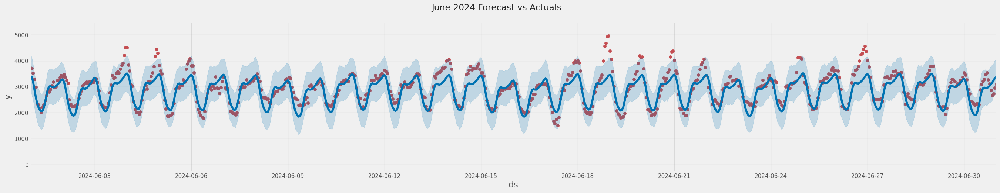

In [ ]:
fig, ax = plt.subplots(figsize=(30, 5))
ax.scatter(df_test.index, df_test['value'], color='r')
fig = model.plot(df_test_forecast, ax=ax)
# Convert date strings to datetime objects using pandas.to_datetime
lower_bound = pd.to_datetime('2024-06-01')  # Use 'YYYY-MM-DD' format
upper_bound = pd.to_datetime('2024-07-01')

ax.set_xbound(lower=lower_bound, upper=upper_bound)
plot = plt.suptitle('June 2024 Forecast vs Actuals')
plt.show()


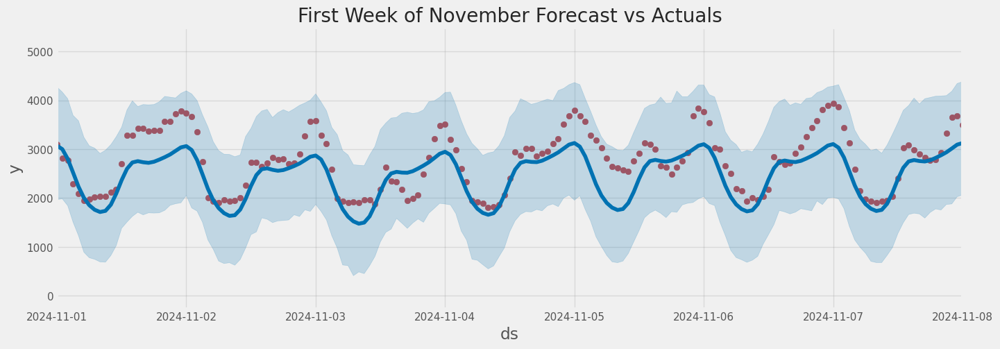

In [ ]:
# Plot the forecast with the actuals
f, ax = plt.subplots(figsize=(15, 5))
ax.scatter(df_test.index, df_test['value'], color='r')
fig = model.plot(df_test_forecast, ax=ax)

lower_bound = pd.to_datetime('2024-11-01')  # Use 'YYYY-MM-DD' format
upper_bound = pd.to_datetime('2024-11-08')

ax.set_xbound(lower=lower_bound, upper=upper_bound)

# ax.set_ylim(0, 60000)
ax.set_title('First Week of November Forecast vs Actuals')
plt.show()

### Prophet 

In [ ]:
from prophet import Prophet
import pandas as pd
df = pd.read_csv("/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/data/dataset/energy_generated_data.csv",parse_dates=True)
df = df.sort_index() 
columnstodrop = ['respondent','respondent-name','fueltype','type-name','value-units']
df.drop(columns=columnstodrop, axis=1, inplace=True)
df = df.rename(columns={'period':'ds',
                     'value':'y'}) 
df['ds'] = pd.to_datetime(df['ds'], format='%Y-%m-%dT%H')
print(type(df))
df.head()

/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/energy/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



<class 'pandas.core.frame.DataFrame'>


,ds,y
0,2024-12-01 00:00:00,3590
1,2024-11-30 23:00:00,3630
2,2024-11-30 22:00:00,3591
3,2024-11-30 21:00:00,3387
4,2024-11-30 20:00:00,2972


In [ ]:
# Python
m = Prophet()
m.fit(df)

08:45:54 - cmdstanpy - INFO - Chain [1] start processing
08:46:28 - cmdstanpy - INFO - Chain [1] done processing


In [ ]:
# Save the trained model
import joblib
joblib.dump(m, "/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/notebooks/prophet_model.pkl")

['/home/karthikponna/kittu/Energy generation prediction project/Energy-Generation-Predictor-MLops/notebooks/prophet_model.pkl']

In [ ]:
# Python
future = m.make_future_dataframe(periods=365)
future.tail()

,ds
25921,2025-11-27
25922,2025-11-28
25923,2025-11-29
25924,2025-11-30
25925,2025-12-01


In [ ]:
# Python
forecast = m.predict(future)
forecast.tail()


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
25921,2025-11-27,2480.373467,1832.362531,4421.957942,1287.096941,3737.220261,630.608875,630.608875,630.608875,622.183091,...,42.601002,42.601002,42.601002,-34.175218,-34.175218,-34.175218,0.0,0.0,0.0,3110.982342
25922,2025-11-28,2479.254613,1862.167485,4451.719977,1284.254155,3747.023222,656.853732,656.853732,656.853732,622.183091,...,56.126333,56.126333,56.126333,-21.455692,-21.455692,-21.455692,0.0,0.0,0.0,3136.108344
25923,2025-11-29,2478.135759,1829.646251,4406.292724,1281.411368,3755.303794,643.404754,643.404754,643.404754,622.183091,...,30.780096,30.780096,30.780096,-9.558434,-9.558434,-9.558434,0.0,0.0,0.0,3121.540513
25924,2025-11-30,2477.016905,1611.085715,4298.100719,1278.568582,3761.381080,456.771186,456.771186,456.771186,622.183091,...,-166.916877,-166.916877,-166.916877,1.504973,1.504973,1.504973,0.0,0.0,0.0,2933.788091
25925,2025-12-01,2475.898051,1729.468173,4342.491049,1275.725795,3767.458365,543.163757,543.163757,543.163757,622.183091,...,-90.756861,-90.756861,-90.756861,11.737527,11.737527,11.737527,0.0,0.0,0.0,3019.061808


In [ ]:
from prophet.plot import plot_plotly, plot_components_plotly

plot_plotly(m, forecast)

In [ ]:
plot_components_plotly(m, forecast)

In [ ]:
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar

cal = calendar()


holidays = cal.holidays(start=df.index.min(),
                        end=df.index.max(),
                        return_name=True)
holiday_df = pd.DataFrame(data=holidays,
                          columns=['holiday'])
holiday_df = holiday_df.reset_index().rename(columns={'index':'ds'})

In [ ]:
%%time
model_with_holidays = Prophet(holidays=holiday_df)
model_with_holidays.fit(df)

08:47:40 - cmdstanpy - INFO - Chain [1] start processing
08:48:14 - cmdstanpy - INFO - Chain [1] done processing


CPU times: user 5.14 s, sys: 1.83 s, total: 6.97 s
Wall time: 41.3 s


In [ ]:
# Predict on training set with model
forecast_with_holidays = model_with_holidays.predict(df=future)

In [ ]:
plot_plotly(model_with_holidays, forecast_with_holidays)

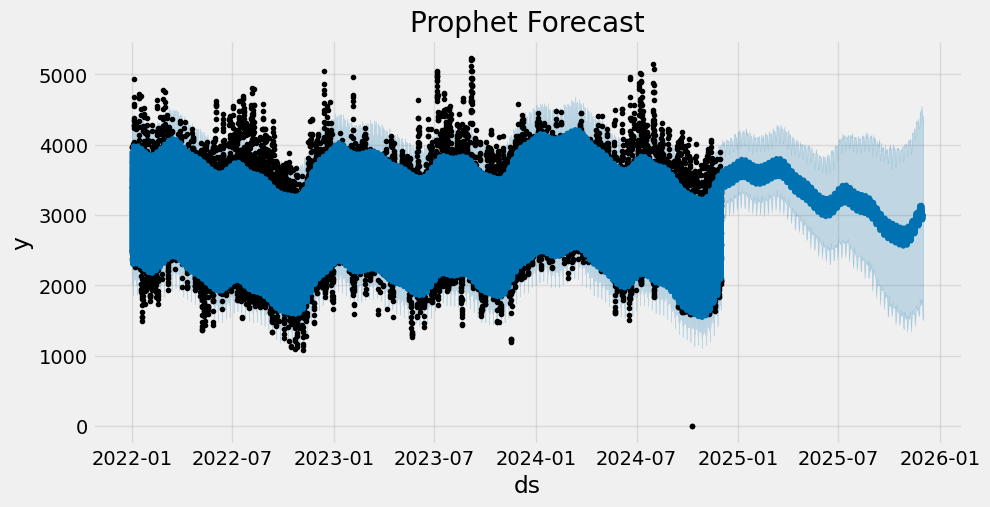

In [ ]:
fig, ax = plt.subplots(figsize=(10, 5))
fig = model_with_holidays.plot(forecast_with_holidays, ax=ax)
ax.set_title('Prophet Forecast')
plt.show()

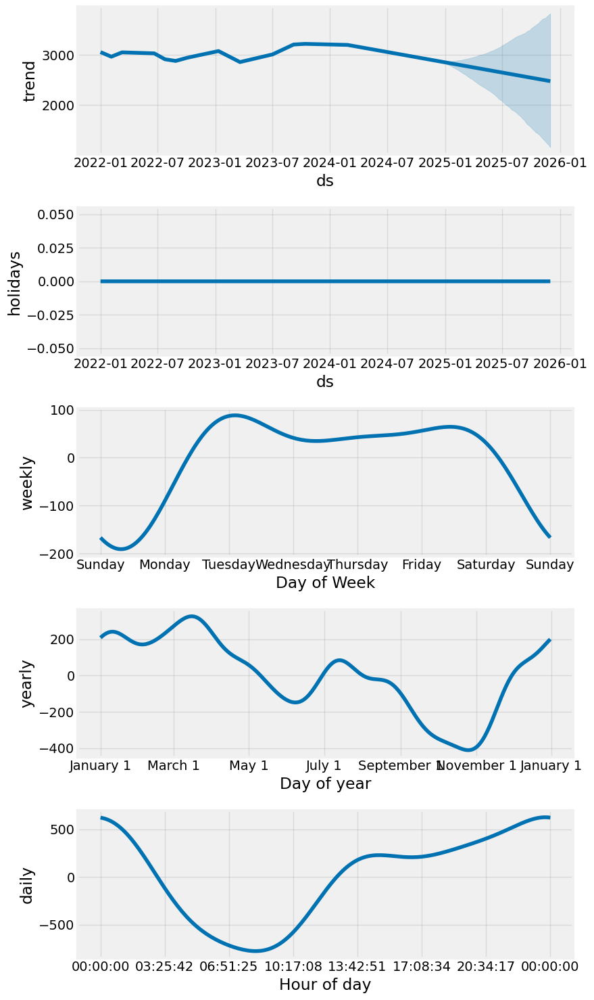

In [ ]:
fig = model_with_holidays.plot_components(
    forecast_with_holidays)
plt.show()

Combined Model Metrics

In [ ]:
metrics = {
    "Model": ["GRU", "GRU", "GRU", "LSTM", "LSTM", "LSTM", "CONV", "CONV", "CONV","XGBOOST",'XGBOOST'],
    "Dataset": ["Train", "Validation", "Test", "Train", "Validation", "Test", "Train", "Validation", "Test","Train","Test"],
    "MAE": [128.074907, 120.378577, 122.566104, 129.504066, 132.078705, 120.155095, 134.774344, 118.818230, 126.197184,23.5319, 30.6254],
    "MSE": [28845.085620, 23978.625464, 28192.139937, 29423.001937, 27574.907890, 27652.529745, 
            31422.307641, 23444.142409, 29203.894119,1091.8503, 3800.5774],
    "RMSE": [169.838410, 154.850332, 167.905152, 171.531344, 166.056942, 166.290498, 177.263385, 
             153.114801, 170.891469,33.0432, 61.6488],
    "R²": [0.925734, 0.911802, 0.926688, 0.924246, 0.898574, 0.928091, 0.919098, 0.913768, 0.924056,0.9971, 0.9903]
}

# Create the DataFrame
metrics_df = pd.DataFrame(data)

metrics_df

,Model,Dataset,MAE,MSE,RMSE,R²
0,GRU,Train,128.074907,28845.085620,169.838410,0.925734
1,GRU,Validation,120.378577,23978.625464,154.850332,0.911802
2,GRU,Test,122.566104,28192.139937,167.905152,0.926688
3,LSTM,Train,129.504066,29423.001937,171.531344,0.924246
4,LSTM,Validation,132.078705,27574.907890,166.056942,0.898574
5,LSTM,Test,120.155095,27652.529745,166.290498,0.928091
6,CONV,Train,134.774344,31422.307641,177.263385,0.919098
7,CONV,Validation,118.818230,23444.142409,153.114801,0.913768
8,CONV,Test,126.197184,29203.894119,170.891469,0.924056
9,XGBOOST,Train,23.531900,1091.850300,33.043200,0.997100
